<a href="https://colab.research.google.com/github/SumathiGit/Image-Captioning-Pytorch/blob/main/Test_TF.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [1]:
import numpy as np 
import pandas as pd
import os
import tensorflow as tf
from keras.preprocessing.sequence import pad_sequences
from keras.preprocessing.text import Tokenizer
from keras.models import Model
from keras.layers import Flatten, Dense, LSTM, Dropout, Embedding, Activation
from keras.layers import concatenate, BatchNormalization, Input
from keras.layers.merge import add
from tensorflow.keras.utils import to_categorical
from keras.applications.inception_v3 import InceptionV3, preprocess_input
from tensorflow.keras.utils import plot_model

import matplotlib.pyplot as plt
import cv2
import string
import time
print("Running.....")

Running.....


In [8]:
import glob
images = '/content/drive/MyDrive/flic/ImgData/Flicker8k_Dataset/'
# Create a list of all image names in the directory
img = glob.glob(images + '*.jpg')
len(img)

8104

In [ ]:
token_path = '/content/drive/MyDrive/flic/captions1/token1.txt'
text = open(token_path, 'r', encoding = 'utf-8').read()
print(text[:500])

In [10]:
train_path = '/content/drive/MyDrive/flic/captions1/train1.txt'
train_images = open(train_path, 'r', encoding = 'utf-8').read().split("\n")
train_img = []

for im in img:
    if(im[len(images):] in train_images):
        train_img.append(im)

In [11]:
def load_description(text):
    mapping = dict()
    for line in text.split("\n"):
        token = line.split("\t")
        if len(line) < 2:
            continue
        img_id = token[0].split('.')[0]
        img_des = token[1]
        if img_id not in mapping:
            mapping[img_id] = list()
        mapping[img_id].append(img_des)
    return mapping

descriptions = load_description(text)
print("Number of items: " + str(len(descriptions)))

Number of items: 8105


In [12]:
def clean_description(desc):
    for key, des_list in desc.items():
        for i in range(len(des_list)):
            caption = des_list[i]
            caption = [ch for ch in caption if ch not in string.punctuation]
            caption = ''.join(caption)
            caption = caption.split(' ')
            caption = [word.lower() for word in caption if len(word)>1 and word.isalpha()]
            caption = ' '.join(caption)
            des_list[i] = caption

clean_description(descriptions)
descriptions['1000268201_693b08cb0e']

['child in pink dress is climbing up set of stairs in an entry way',
 'girl going into wooden building',
 'little girl climbing into wooden playhouse',
 'little girl climbing the stairs to her playhouse',
 'little girl in pink dress going into wooden cabin']

In [13]:
#load descriptions of train and test set separately
def load_clean_descriptions(des, dataset):
    dataset_des = dict()
    for key, des_list in des.items():
        if key+'.jpg' in dataset:
            if key not in dataset_des:
                dataset_des[key] = list()
            for line in des_list:
                desc = 'startseq ' + line + ' endseq'
                dataset_des[key].append(desc)
    return dataset_des

train_descriptions = load_clean_descriptions(descriptions, train_images)
print('Descriptions: train=%d' % len(train_descriptions))
train_descriptions['1000268201_693b08cb0e']

Descriptions: train=6012


['startseq child in pink dress is climbing up set of stairs in an entry way endseq',
 'startseq girl going into wooden building endseq',
 'startseq little girl climbing into wooden playhouse endseq',
 'startseq little girl climbing the stairs to her playhouse endseq',
 'startseq little girl in pink dress going into wooden cabin endseq']

In [15]:
import glob
images = '/content/drive/MyDrive/flic/images/'
# Create a list of all image names in the directory
img = glob.glob(images + '*.jpg')
len(img)

268

In [16]:
test_path = '/content/drive/MyDrive/flic/images.txt'
test_images = open(test_path, 'r', encoding = 'utf-8').read().split("\n")
test_img = []

for im in img:
    if(im[len(images): ] in test_images):
        test_img.append(im)
len(test_img)

268

In [17]:
from keras.preprocessing.image import load_img, img_to_array
def preprocess_img(img_path):
    #inception v3 excepts img in 299*299
    img = load_img(img_path, target_size = (299, 299))
    x = img_to_array(img)
    # Add one more dimension
    x = np.expand_dims(x, axis = 0)
    x = preprocess_input(x)
    return x

In [ ]:
base_model = InceptionV3(weights = 'imagenet')
base_model.summary()

In [19]:
model = Model(base_model.input, base_model.layers[-2].output)

In [20]:
def encode(image):
    image = preprocess_img(image)
    vec = model.predict(image)
    vec = np.reshape(vec, (vec.shape[1]))
    return vec

In [21]:
#Encode all the test images
start = time.time()
encoding_test = {}
for img in test_img:
    encoding_test[img[len(images):]] = encode(img)
print("Time taken is: " + str(time.time() - start))

Time taken is: 134.47679257392883


In [22]:
test_features = encoding_test
print("Test image encodings: " + str(len(test_features)))
print(test_features)
print(type(test_features))

Test image encodings: 268
{'image_1.jpg': array([0.04221665, 0.4650726 , 0.9303441 , ..., 0.02586802, 0.16793872,
       0.61178267], dtype=float32), 'image_2.jpg': array([0.06349377, 0.48073483, 0.96475554, ..., 0.04559473, 0.20106888,
       0.64191616], dtype=float32), 'image_3.jpg': array([0.08455089, 0.51564515, 0.96406   , ..., 0.03716218, 0.33843446,
       0.8020079 ], dtype=float32), 'image_4.jpg': array([0.09507249, 0.4753778 , 0.88752717, ..., 0.01237094, 0.26508236,
       0.74932325], dtype=float32), 'image_5.jpg': array([0.05864256, 0.41112816, 0.9737714 , ..., 0.04673591, 0.2738682 ,
       0.760697  ], dtype=float32), 'image_6.jpg': array([0.0760638 , 0.47893256, 0.9326781 , ..., 0.05410126, 0.19123796,
       0.8500766 ], dtype=float32), 'image_7.jpg': array([0.07108209, 0.42568105, 0.77642334, ..., 0.05603402, 0.18148455,
       0.8819501 ], dtype=float32), 'image_8.jpg': array([0.08676244, 0.41049415, 0.7984656 , ..., 0.05957394, 0.2352064 ,
       0.84070796], dtype

In [23]:
test_features['image_1.jpg'].shape

(2048,)

In [ ]:
""" word Embeddings """

In [24]:
import pickle 
with open("/content/drive/MyDrive/flic/ixtoword.pkl", "rb") as f1:
    ixtoword = pickle.load(f1)
    print(ixtoword)

{1: 'startseq', 2: 'child', 3: 'in', 4: 'pink', 5: 'dress', 6: 'is', 7: 'climbing', 8: 'up', 9: 'set', 10: 'of', 11: 'stairs', 12: 'an', 13: 'way', 14: 'endseq', 15: 'girl', 16: 'going', 17: 'into', 18: 'wooden', 19: 'building', 20: 'little', 21: 'the', 22: 'to', 23: 'her', 24: 'black', 25: 'dog', 26: 'and', 27: 'spotted', 28: 'are', 29: 'fighting', 30: 'tricolored', 31: 'playing', 32: 'with', 33: 'each', 34: 'other', 35: 'on', 36: 'road', 37: 'white', 38: 'brown', 39: 'spots', 40: 'staring', 41: 'at', 42: 'street', 43: 'two', 44: 'dogs', 45: 'different', 46: 'looking', 47: 'pavement', 48: 'moving', 49: 'toward', 50: 'covered', 51: 'paint', 52: 'sits', 53: 'front', 54: 'painted', 55: 'rainbow', 56: 'hands', 57: 'bowl', 58: 'sitting', 59: 'large', 60: 'small', 61: 'grass', 62: 'plays', 63: 'it', 64: 'there', 65: 'pigtails', 66: 'painting', 67: 'young', 68: 'outside', 69: 'man', 70: 'lays', 71: 'bench', 72: 'while', 73: 'his', 74: 'by', 75: 'him', 76: 'which', 77: 'also', 78: 'tied', 79:

In [25]:
vocab_size = len(ixtoword) + 1  #1 for appended zeros
vocab_size

1652

In [26]:
embeddings_index = {}
glove = open('/content/drive/MyDrive/flic/Glove/glove.6B.200d.txt', 'r', encoding = 'utf-8').read()
for line in glove.split("\n"):
    values = line.split(" ")
    word = values[0]
    indices = np.asarray(values[1: ], dtype = 'float32')
    embeddings_index[word] = indices
print('Total word vectors: ' + str(len(embeddings_index)))

Total word vectors: 400001


In [27]:
import pickle 
with open("/content/drive/MyDrive/flic/wordtoix.pkl", "rb") as f2:
    wordtoix = pickle.load(f2)
    print(wordtoix)

{'startseq': 1, 'child': 2, 'in': 3, 'pink': 4, 'dress': 5, 'is': 6, 'climbing': 7, 'up': 8, 'set': 9, 'of': 10, 'stairs': 11, 'an': 12, 'way': 13, 'endseq': 14, 'girl': 15, 'going': 16, 'into': 17, 'wooden': 18, 'building': 19, 'little': 20, 'the': 21, 'to': 22, 'her': 23, 'black': 24, 'dog': 25, 'and': 26, 'spotted': 27, 'are': 28, 'fighting': 29, 'tricolored': 30, 'playing': 31, 'with': 32, 'each': 33, 'other': 34, 'on': 35, 'road': 36, 'white': 37, 'brown': 38, 'spots': 39, 'staring': 40, 'at': 41, 'street': 42, 'two': 43, 'dogs': 44, 'different': 45, 'looking': 46, 'pavement': 47, 'moving': 48, 'toward': 49, 'covered': 50, 'paint': 51, 'sits': 52, 'front': 53, 'painted': 54, 'rainbow': 55, 'hands': 56, 'bowl': 57, 'sitting': 58, 'large': 59, 'small': 60, 'grass': 61, 'plays': 62, 'it': 63, 'there': 64, 'pigtails': 65, 'painting': 66, 'young': 67, 'outside': 68, 'man': 69, 'lays': 70, 'bench': 71, 'while': 72, 'his': 73, 'by': 74, 'him': 75, 'which': 76, 'also': 77, 'tied': 78, 'sl

In [28]:
import pickle 
with open("/content/drive/MyDrive/flic/vocab.pkl", "rb") as f:
    vocab = pickle.load(f)
    print(vocab)
    print(type(vocab))
    print(len(vocab))

['startseq', 'child', 'in', 'pink', 'dress', 'is', 'climbing', 'up', 'set', 'of', 'stairs', 'an', 'way', 'endseq', 'girl', 'going', 'into', 'wooden', 'building', 'little', 'the', 'to', 'her', 'black', 'dog', 'and', 'spotted', 'are', 'fighting', 'tricolored', 'playing', 'with', 'each', 'other', 'on', 'road', 'white', 'brown', 'spots', 'staring', 'at', 'street', 'two', 'dogs', 'different', 'looking', 'pavement', 'moving', 'toward', 'covered', 'paint', 'sits', 'front', 'painted', 'rainbow', 'hands', 'bowl', 'sitting', 'large', 'small', 'grass', 'plays', 'it', 'there', 'pigtails', 'painting', 'young', 'outside', 'man', 'lays', 'bench', 'while', 'his', 'by', 'him', 'which', 'also', 'tied', 'sleeping', 'next', 'shirtless', 'lies', 'park', 'laying', 'holding', 'leash', 'ground', 'orange', 'hat', 'something', 'wears', 'glasses', 'wearing', 'beer', 'can', 'ears', 'rope', 'net', 'red', 'climbs', 'bridge', 'onto', 'ropes', 'playground', 'running', 'grassy', 'garden', 'surrounded', 'fence', 'throu

In [29]:
emb_dim = 200
emb_matrix = np.zeros((vocab_size, emb_dim))
for word, i in wordtoix.items():
    emb_vec = embeddings_index.get(word)
    if emb_vec is not None:
        emb_matrix[i] = emb_vec
emb_matrix.shape

(1652, 200)

In [30]:
model.layers[2]

In [31]:
max_length = 10

In [ ]:

#since there are almost 30000 descriptions to process we will use datagenerator
X1, X2, y = list(), list(), list()
for key, des_list in train_descriptions.items():
    for cap in des_list:
        seq = [wordtoix[word] for word in cap.split(' ') if word in wordtoix]
        for i in range(1, len(seq)):
            in_seq, out_seq = seq[:i], seq[i]
            in_seq = pad_sequences([in_seq], maxlen = max_length)[0]
            out_seq = to_categorical([out_seq], num_classes = vocab_size)[0]
            X2.append(in_seq)
            y.append(out_seq)

X2 = np.array(X2)
X1 = np.array(X1)
y = np.array(y)

In [38]:
from keras.models import load_model
model = load_model('/content/drive/MyDrive/flic/img_cap_model.h5')

In [39]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 34)]         0                                            
__________________________________________________________________________________________________
input_2 (InputLayer)            [(None, 2048)]       0                                            
__________________________________________________________________________________________________
embedding (Embedding)           (None, 34, 200)      330400      input_3[0][0]                    
__________________________________________________________________________________________________
dropout (Dropout)               (None, 2048)         0           input_2[0][0]                    
____________________________________________________________________________________________

In [40]:
model.layers[2]

In [50]:
def predict_caption(photo):
    in_text = "startseq"
    for i in range(10):
        sequence = [wordtoix[w] for w in in_text.split() if w in wordtoix]
        sequence = pad_sequences([sequence],34, padding='post')

        ypred =  model.predict([photo,sequence])
        ypred = ypred.argmax()
        word = ixtoword[ypred]
        in_text+= ' ' +word
        
        if word =='endseq':
            break
        
        
    final_caption =  in_text.split()
    final_caption = final_caption[1:-1]
    final_caption = ' '.join(final_caption)
    
    return final_caption

In [64]:
print(type(encoding_test))
print(type(encoding_test.keys))
print(encoding_test.keys)[0]

<class 'dict'>
<class 'builtin_function_or_method'>
<built-in method keys of dict object at 0x7fa7b006ef00>


TypeError: ignored

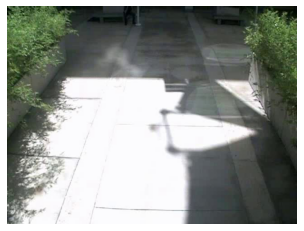

man in black shirt and black pants is walking


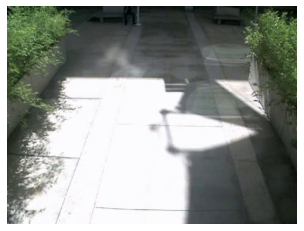

man in white shirt and black pants is walking


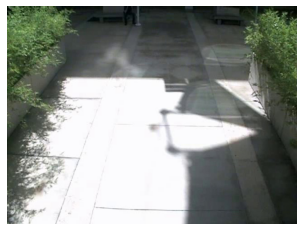

man in white shirt and black pants walking on


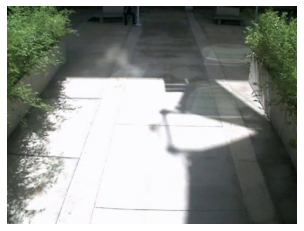

man in white shirt and black pants walking on


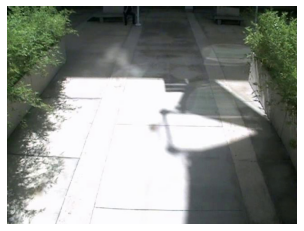

man in white shirt and black pants walking on


In [81]:
for i in range(5):
    # rn =  np.random.randint(0, 268)
    img_name = list(encoding_test.keys())[i]
    photo = encoding_test[img_name].reshape((1,2048))

    i = plt.imread(images+img_name)
    plt.imshow(i)
    plt.axis("off")
    plt.show()

    caption = predict_caption(photo)
    print(caption)

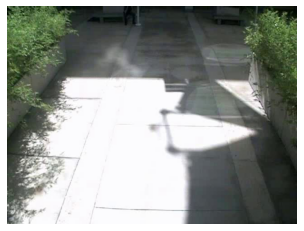

man in black shirt and black pants is walking


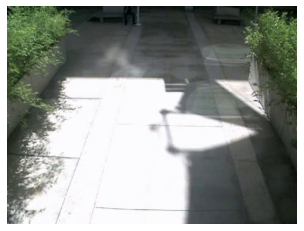

man in white shirt and black pants is walking


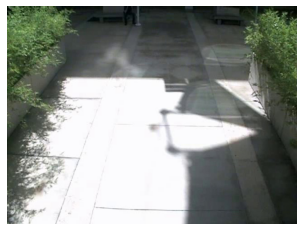

man in white shirt and black pants walking on


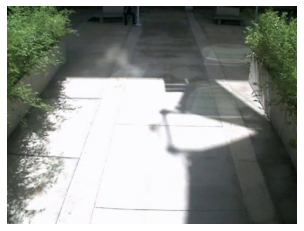

man in white shirt and black pants walking on


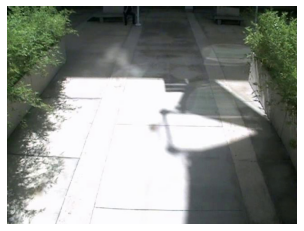

man in white shirt and black pants walking on


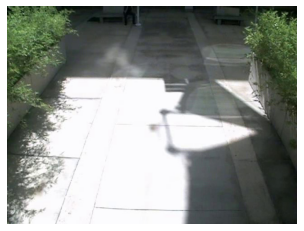

man in white shirt and black pants walking on


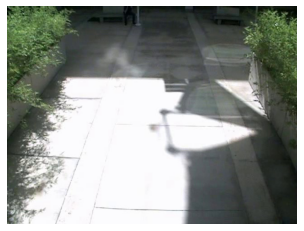

man in white shirt and black pants walking on


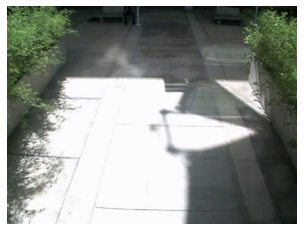

man in white shirt and black pants walking on


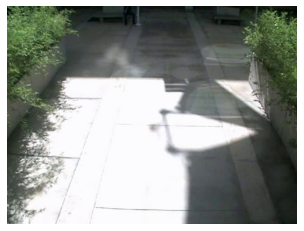

man in white shirt and black pants walking on


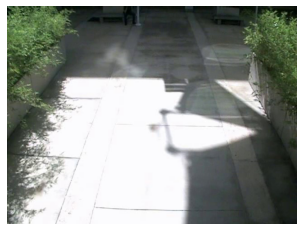

man in white shirt and black pants walking on


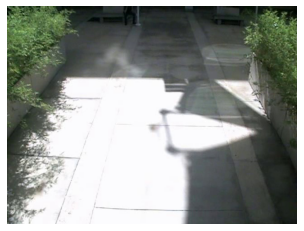

man in white shirt and black pants is walking


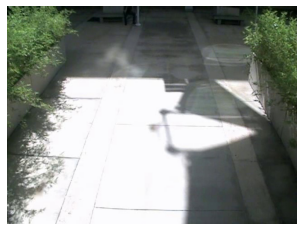

man in white shirt and black pants is walking


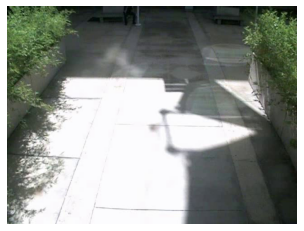

man in white shirt and black pants walking on


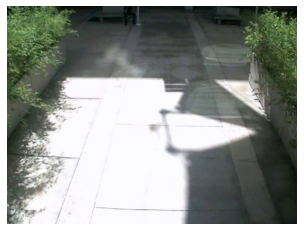

man in white shirt and black pants walking on


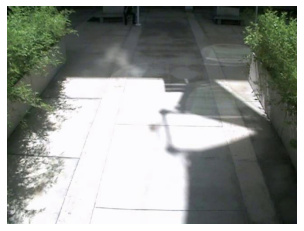

man in white shirt and black pants walking on


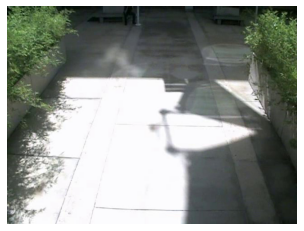

man in white shirt and black pants walking on


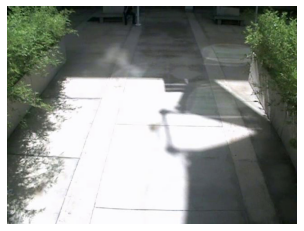

man in white shirt and black pants walking on


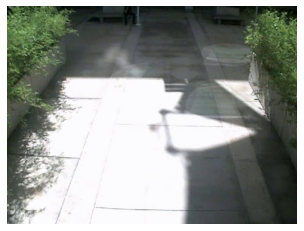

man in black shirt and black pants is walking


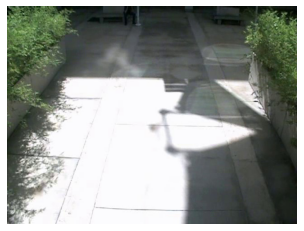

man in white shirt and black pants is walking


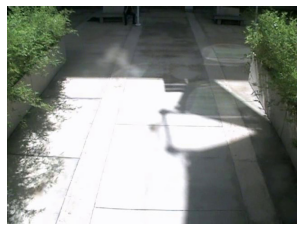

man in white shirt and black pants walking on


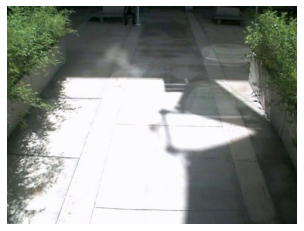

man in black shirt begins to three trees


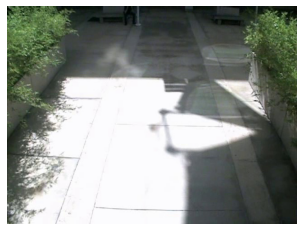

man in black shirt and black pants is walking


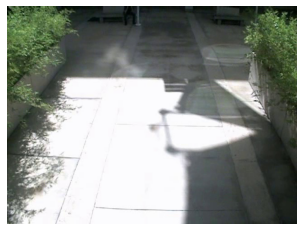

man in white shirt and black pants walking on


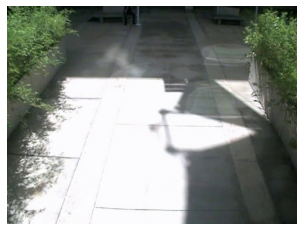

man in black shirt begins to three trees


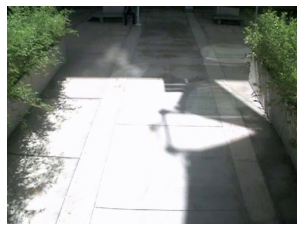

man in black shirt and black pants is walking


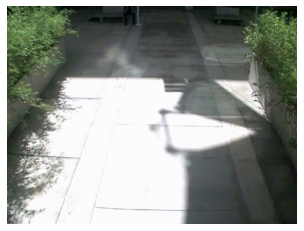

man in black shirt and black pants is walking


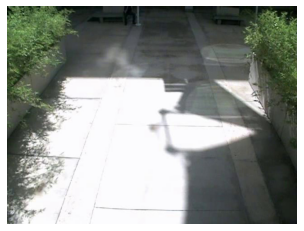

man in white shirt and black pants is walking


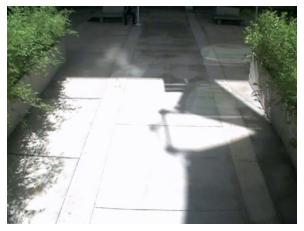

man in black shirt and black pants is walking


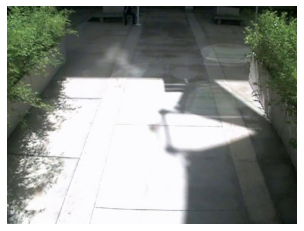

man in black dress and white shirt is walking


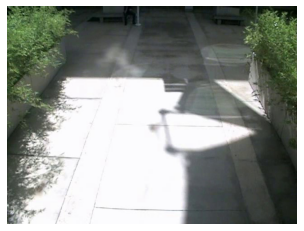

man in white shirt and black pants is walking


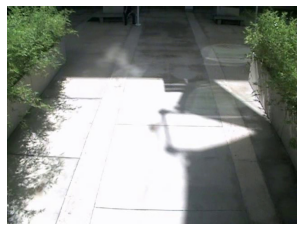

man in white shirt and black pants walking on


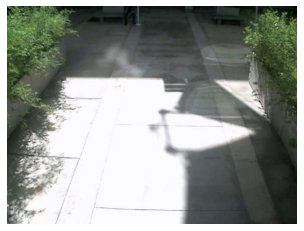

man in black shirt and black pants is walking


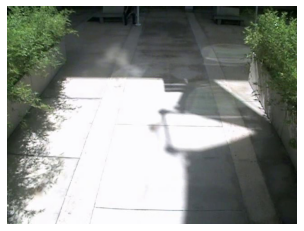

man in black shirt and black pants is walking


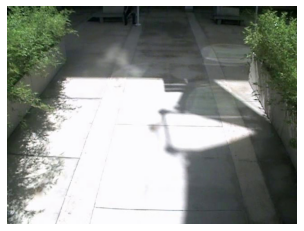

man in white shirt and black pants walking on


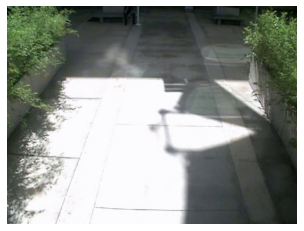

man in white shirt and black pants walking on


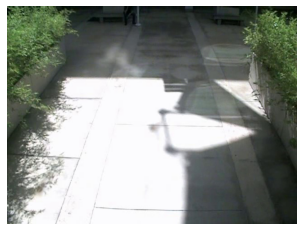

man in white shirt and black pants walking on


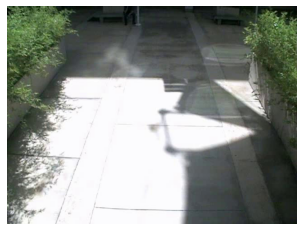

man in white shirt and black pants walks on


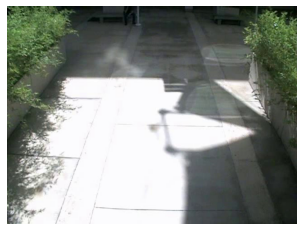

man in black dress and white shirt is walking


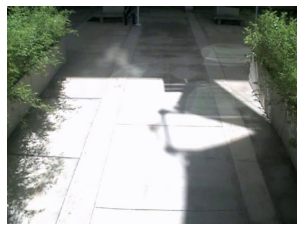

man in white shirt and black pants is walking


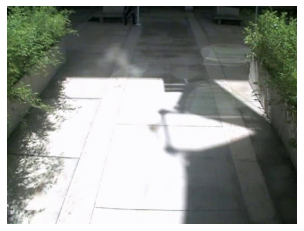

man in black dress and white shirt is walking


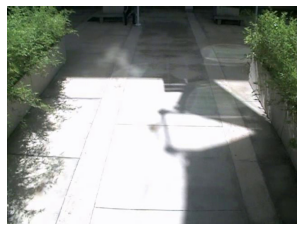

man in black shirt and black pants is walking


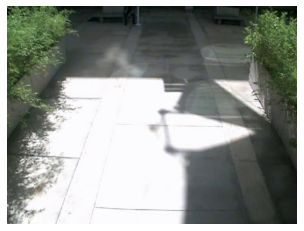

man in white shirt and black pants is walking


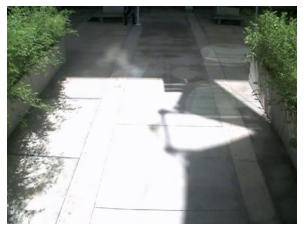

man in white shirt and black pants is walking


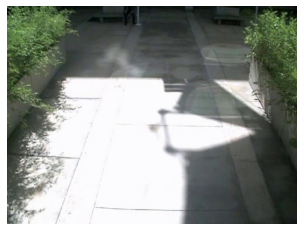

man in white shirt and black pants is walking


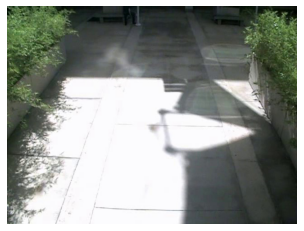

man in white shirt and black pants walking on


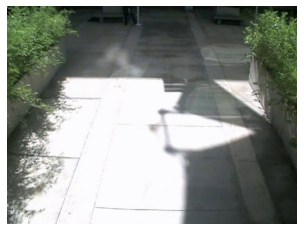

man in red shirt and jeans is walking on


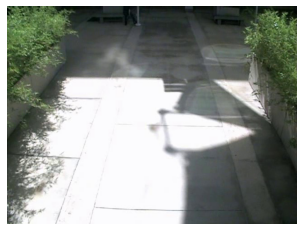

man in white shirt and black pants walking on


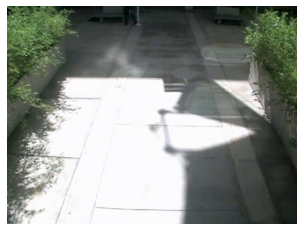

man in red shirt and black pants is walking


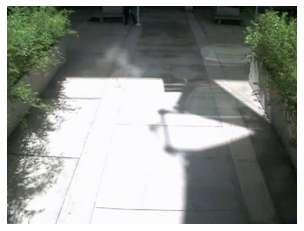

man in white shirt and black pants is walking


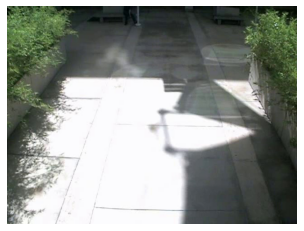

man in black dress and white shirt is walking


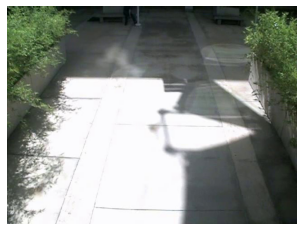

man in white shirt and black pants walking on


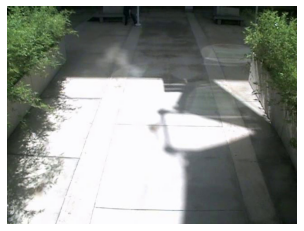

man in white shirt and black pants walking on


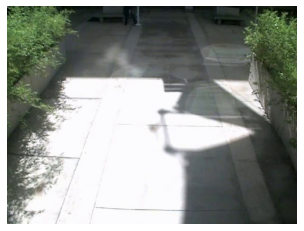

man in black shirt and black pants is walking


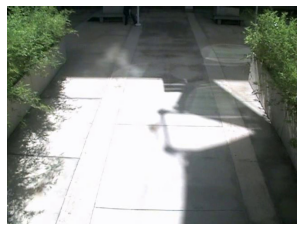

man in white shirt and black pants walking on


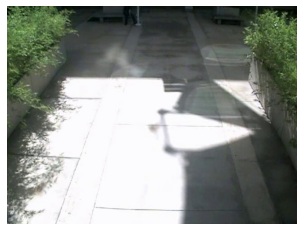

man in black shirt and black pants is walking


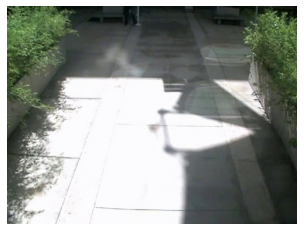

man in white shirt and black pants walking on


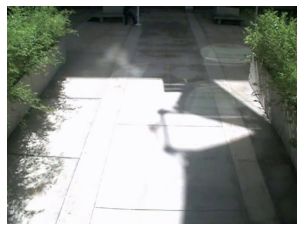

man in white shirt and black pants is walking


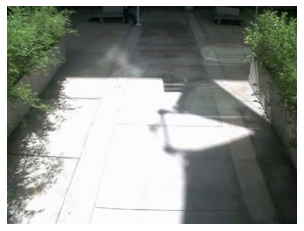

man in white shirt and black pants is walking


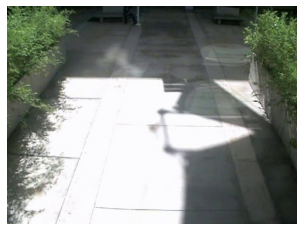

man in white shirt and black pants is walking


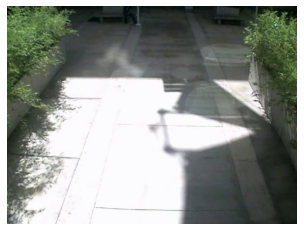

man in black dress and white shirt is walking


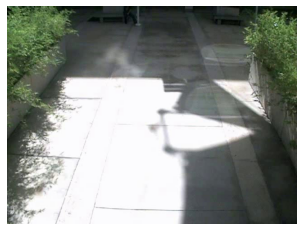

man in white shirt and black pants walking on


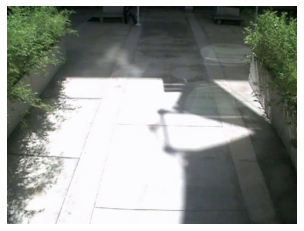

man in white shirt and black pants is walking


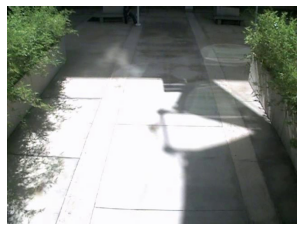

man in white shirt and black pants is walking


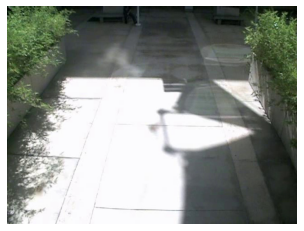

man in black dress and white shirt is walking


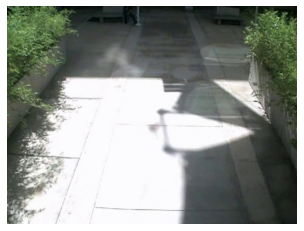

man in white shirt and black pants is walking


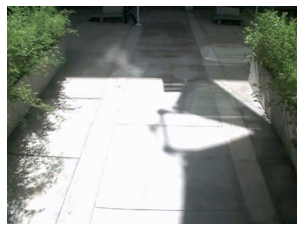

man in black dress and white shirt is walking


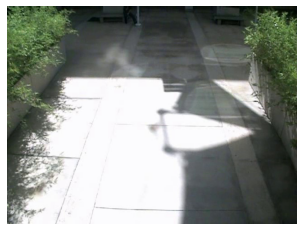

man in black shirt and jeans is walking on


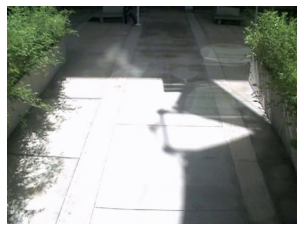

man in black shirt and jeans is walking on


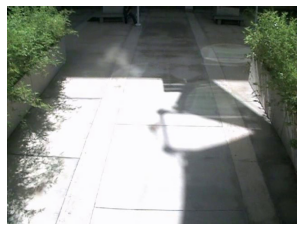

man in white shirt and black pants walking on


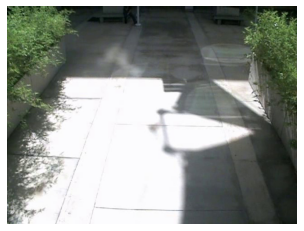

man in white shirt and black pants is walking


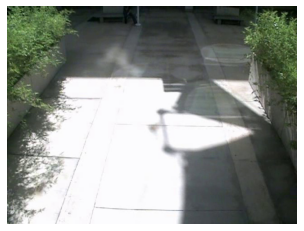

man in white shirt and black pants is walking


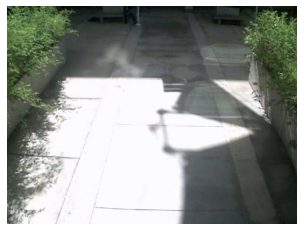

man in white shirt and black pants is walking


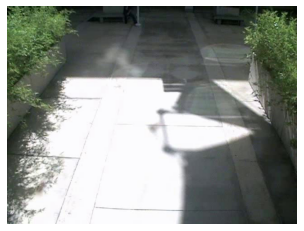

man in black shirt and black pants is walking


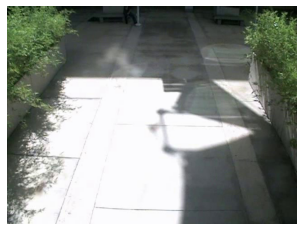

man in black shirt and jeans is walking on


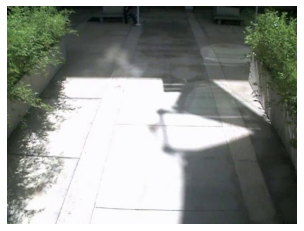

man in white shirt and black pants is walking


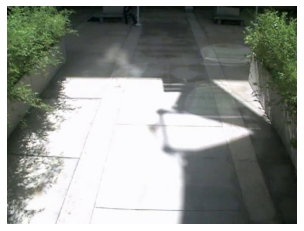

man in black shirt and jeans is walking on


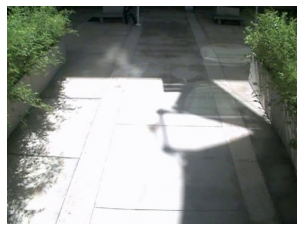

man in white shirt and black pants is walking


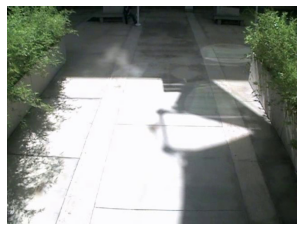

man in black shirt and black pants is walking


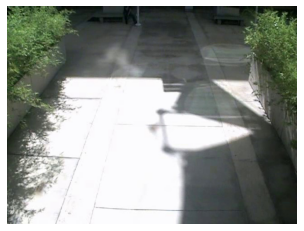

man in black shirt and jeans is walking on


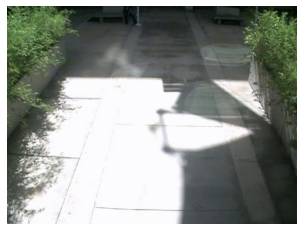

man in black shirt and jeans is walking on


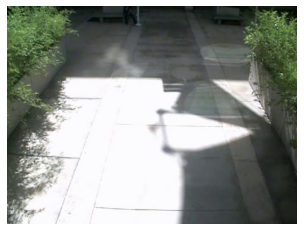

man in black shirt and jeans is walking on


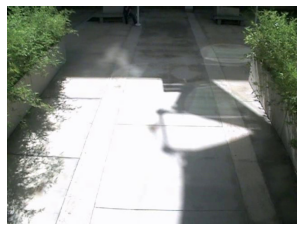

man in white shirt and black pants walking on


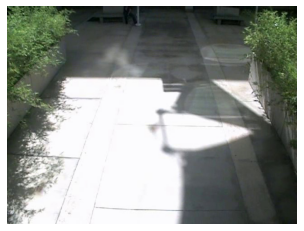

man in black shirt and black pants is walking


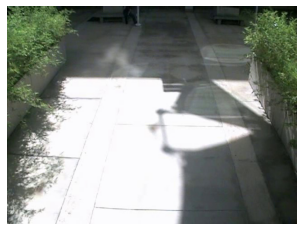

man in white shirt and black pants walking on


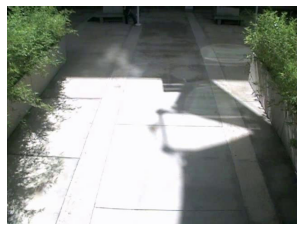

man in black shirt and jeans is walking on


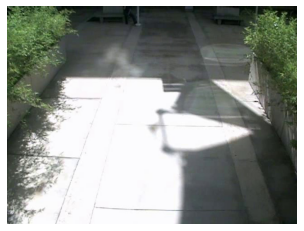

man in white shirt and black pants is walking


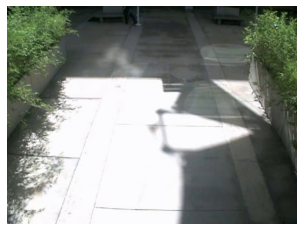

man in black shirt and black pants is walking


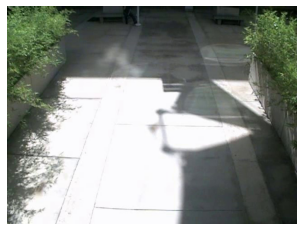

man in white shirt and black pants walking on


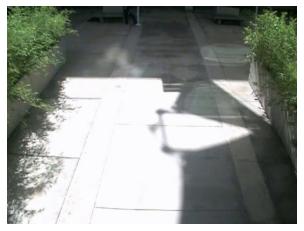

man in white shirt and black pants walking on


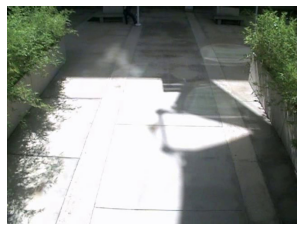

man in white shirt and black pants is walking


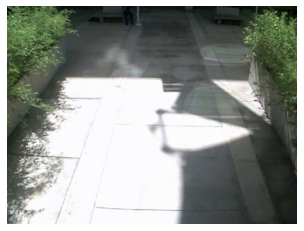

man in white shirt and black pants walking on


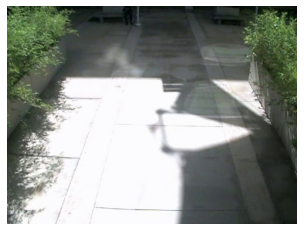

man in white shirt and black pants is walking


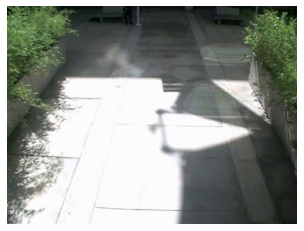

man in white shirt and black pants is walking


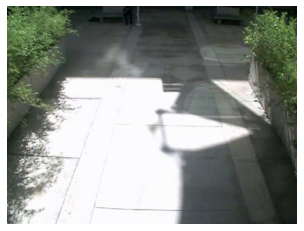

man in black dress and white shirt is walking


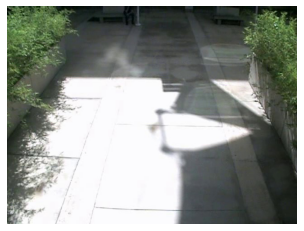

man in white shirt and black pants is walking


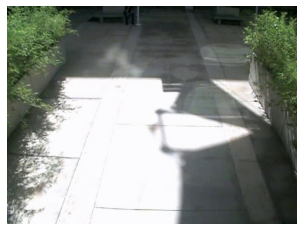

man in black dress and white shirt is walking


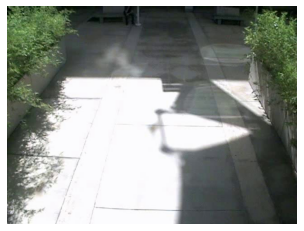

man in white shirt and black pants walking on


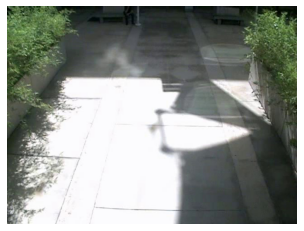

man in black shirt and black pants is walking


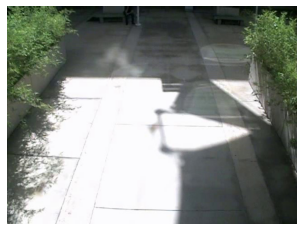

man in white shirt and black pants is walking


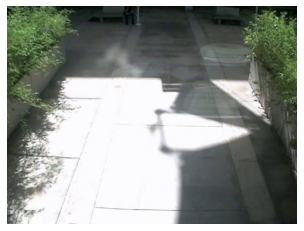

man in black dress and white shirt is walking


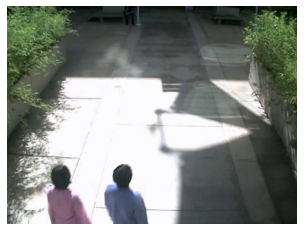

man in white shirt and jeans is walking on


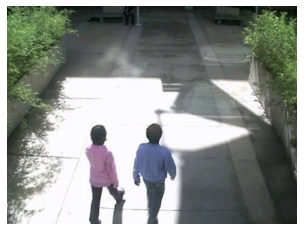

two people are walking on sidewalk


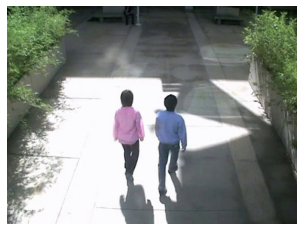

two people are walking past building with lot of


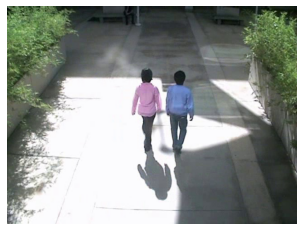

woman in yellow shirt and blue jeans walks down


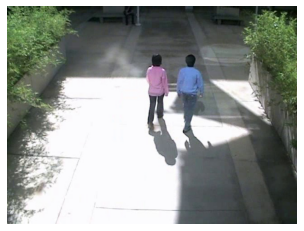

woman in yellow shirt and black pants is walking


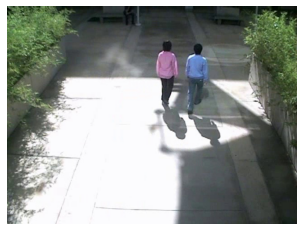

man in black shirt and jeans is walking down


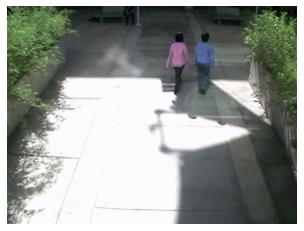

man in blue shirt and jeans is walking down


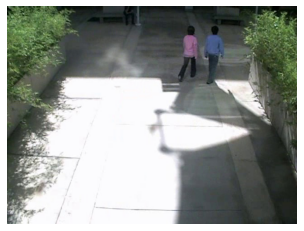

man in red shirt and jeans walks down street


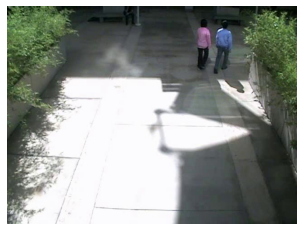

man in white shirt and jeans is walking on


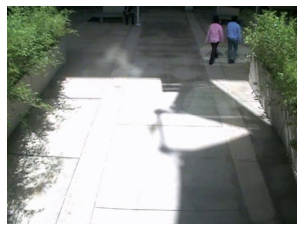

man in red shirt and jeans is riding bike


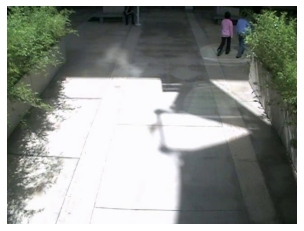

man in white shirt and jeans is walking on


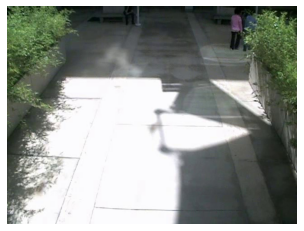

man in black shirt and black pants is walking


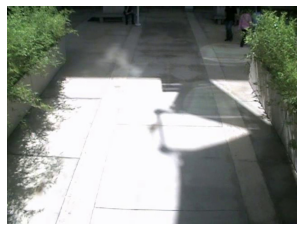

man in black shirt and black pants is walking


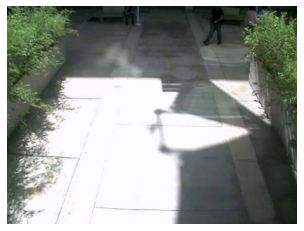

man in black shirt and jeans is walking on


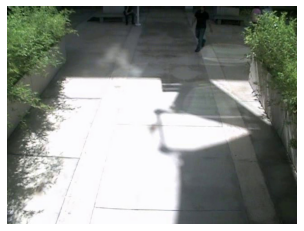

man in white shirt and black pants walking on


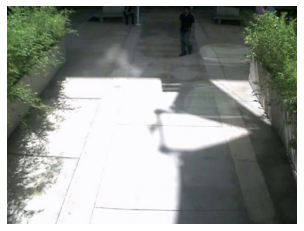

man in black shirt and jeans is walking on


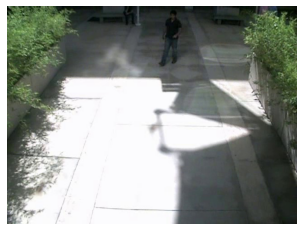

man in white shirt and black pants walking on


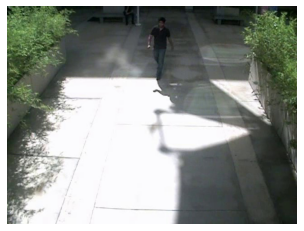

man in red shirt and black pants walks on


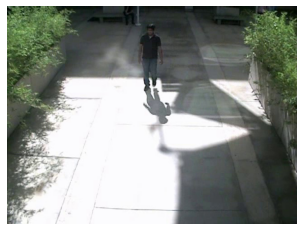

man in red shirt and jeans is walking on


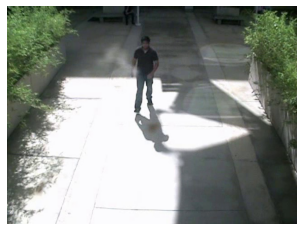

man in black shirt and jeans rides his bike


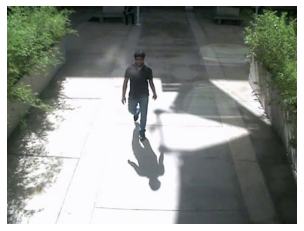

man in red shirt and jeans walks down street


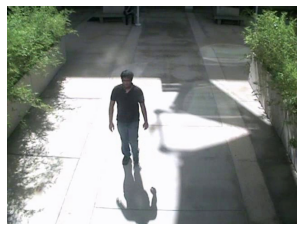

man in red shirt and jeans walks down city


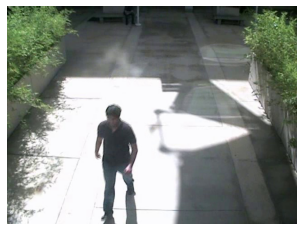

man in blue shirt and black pants is walking


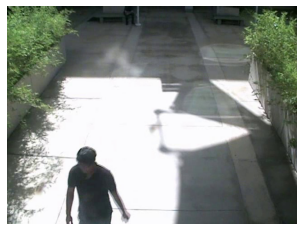

man in red shirt is standing on sidewalk


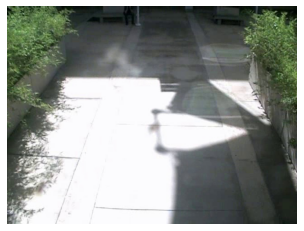

man in white shirt and black pants is walking


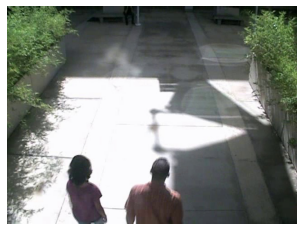

man in white shirt and blue jeans is walking


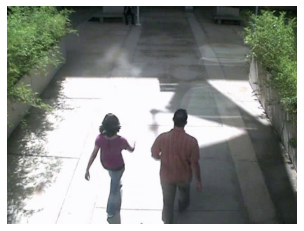

two people are walking on path outside of building


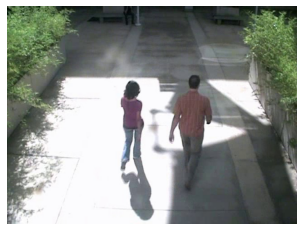

two people walking down the street


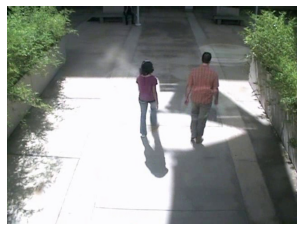

two people are walking on sidewalk


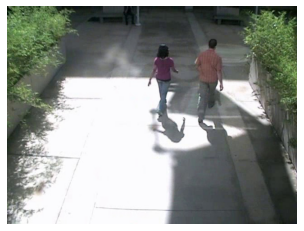

woman in blue shirt and jeans is walking on


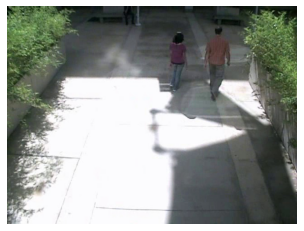

man in blue shirt and jeans is walking down


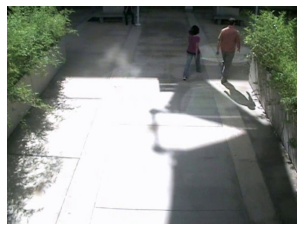

crossing street


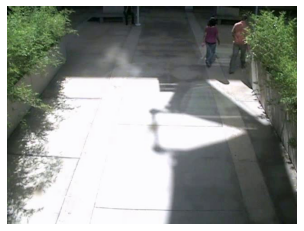

man in white shirt and jeans is walking on


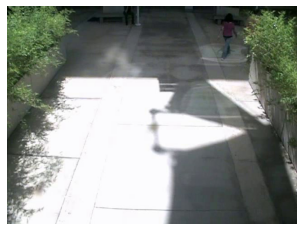

man in white shirt and black pants is walking


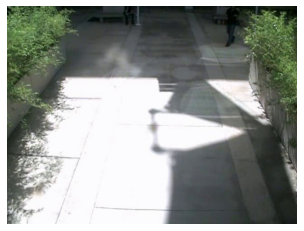

man in black shirt and jeans is walking on


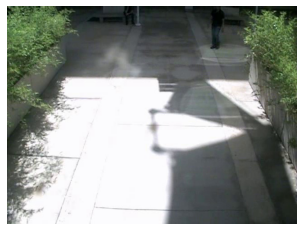

man in black shirt and jeans is walking on


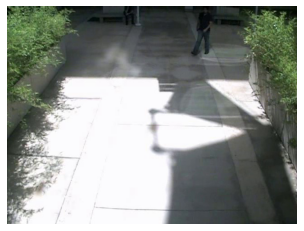

man in black shirt and jeans is walking on


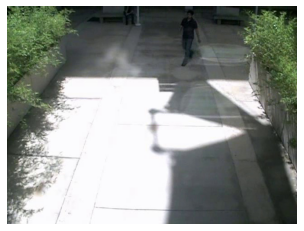

man in black shirt and jeans is walking on


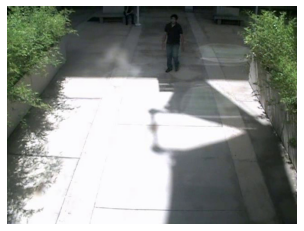

man in red shirt and black pants walks on


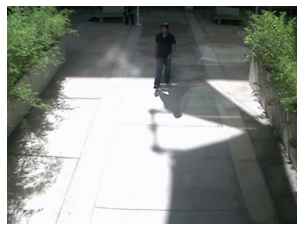

woman in yellow dress walks down busy street


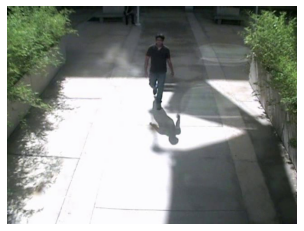

man in black shirt and jeans is walking on


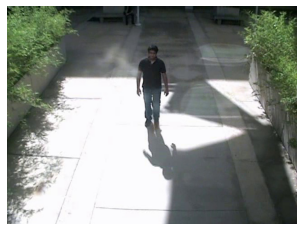

woman in yellow shirt and silver heels walks among


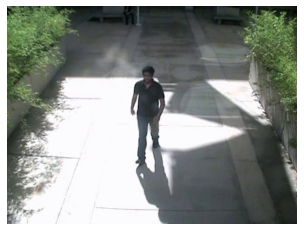

man in red shirt and cap is riding skateboard


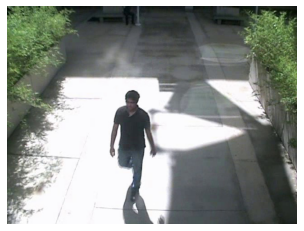

two people are walking on street corner


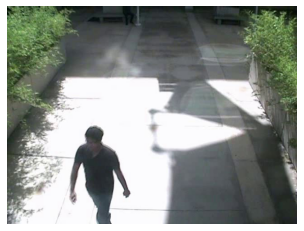

man in red shirt and jeans is standing outside


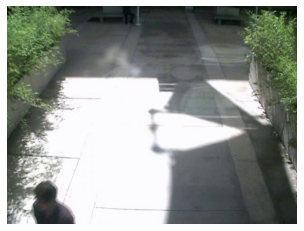

man in blue shirt and jeans is walking on


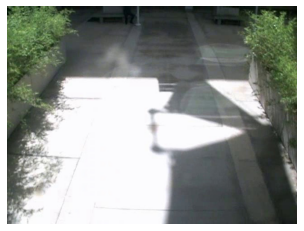

two people are walking on woodland path


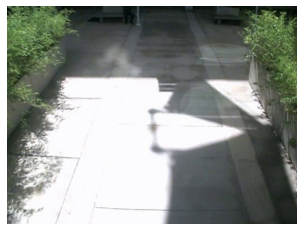

man in black shirt and jeans is walking on


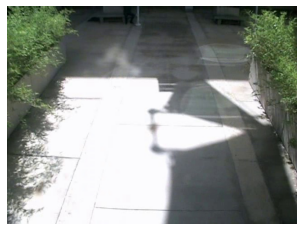

man in black shirt and jeans is walking on


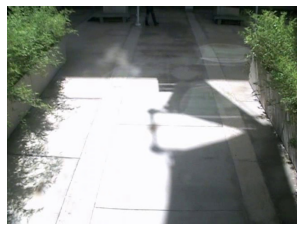

man in black shirt and jeans is walking on


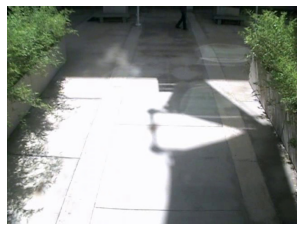

man in black shirt and jeans is walking on


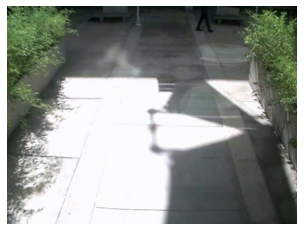

man in black shirt and jeans is walking on


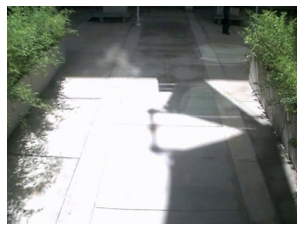

man in black shirt and jeans is walking on


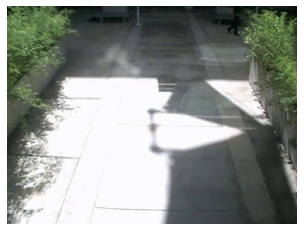

man in black shirt and jeans is walking on


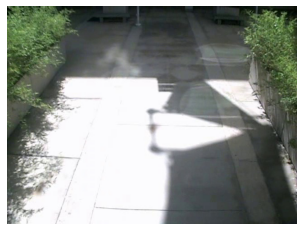

man in white shirt and black pants is walking


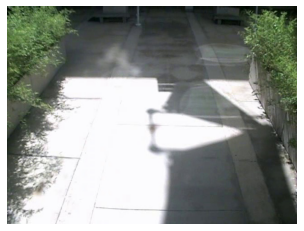

man in black shirt and jeans is walking on


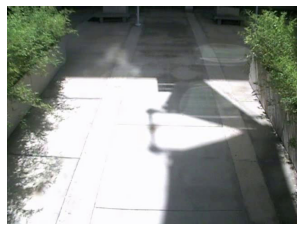

man in black shirt begins to three flowers


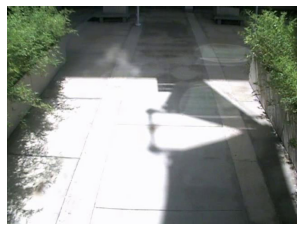

man in black shirt and jeans is walking on


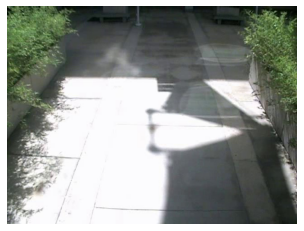

man in black shirt and jeans is walking on


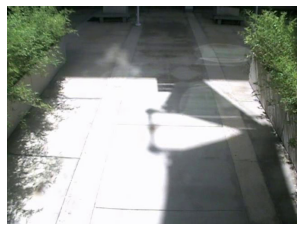

man in black shirt begins to three trees


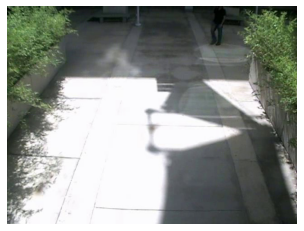

man in black shirt and jeans is walking on


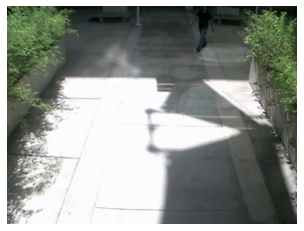

man in black shirt and jeans is walking on


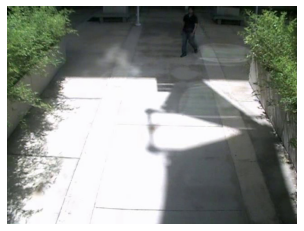

man in black shirt and jeans is walking on


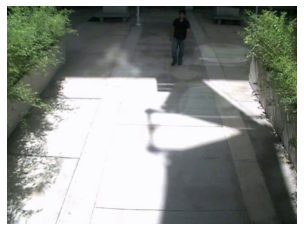

man in black shirt and jeans is walking on


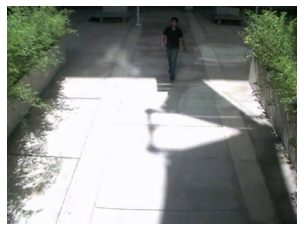

the man is walking racing on street


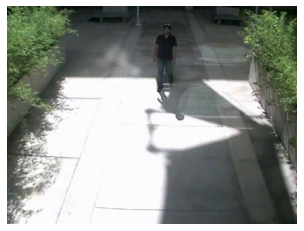

woman in yellow dress walks down busy street


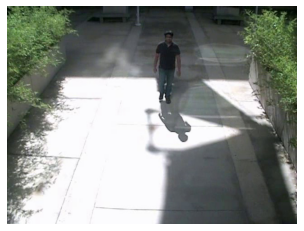

woman in yellow shirt and black pants walks down


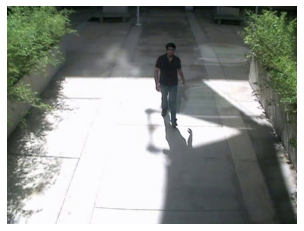

woman in yellow dress walks down busy street


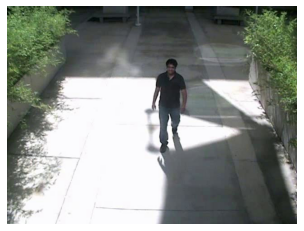

man in blue shirt and jeans is walking on


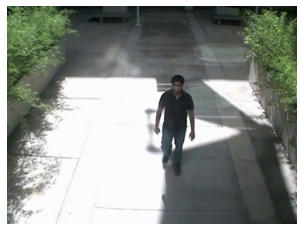

man in red shirt and cap is walking past


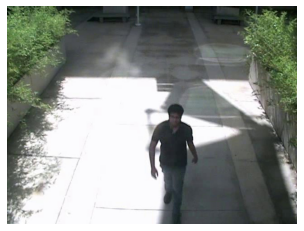

two people are walking on sidewalk


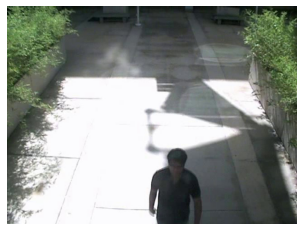

man in red shirt and jeans is walking on


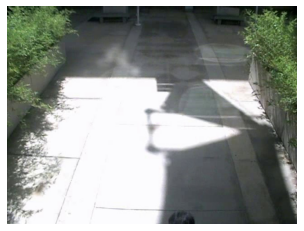

man in black shirt and black pants is walking


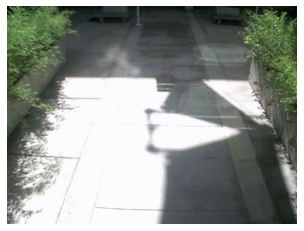

man in black shirt and jeans is walking on


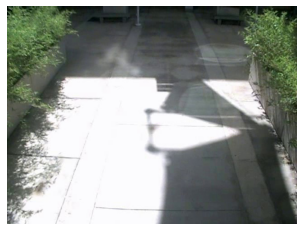

man in black shirt and jeans is walking on


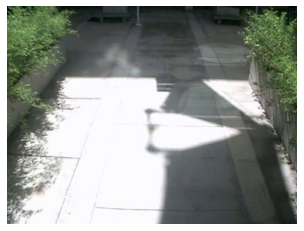

man in black shirt and shorts is walking on


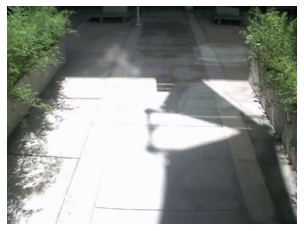

man walking on woodland path


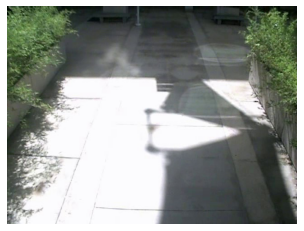

man in black shirt and jeans is walking on


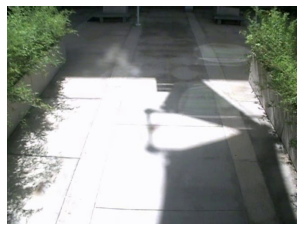

man in blue shirt and blue shoes is walking


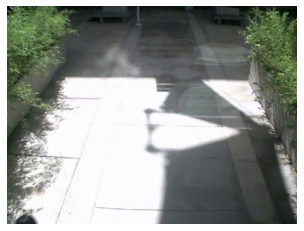

man in black shirt and jeans is walking on


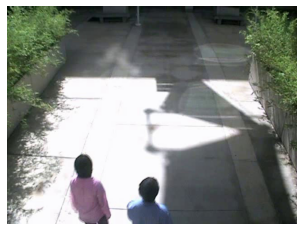

man in blue shirt and blue jeans is walking


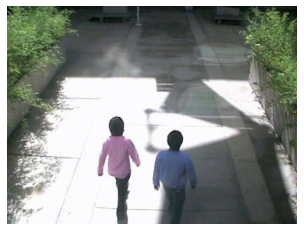

two boys stand outside of building


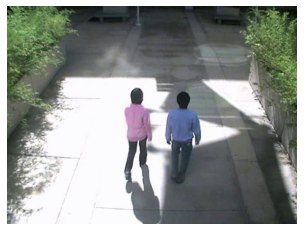

woman in red dress and white shirt walks among


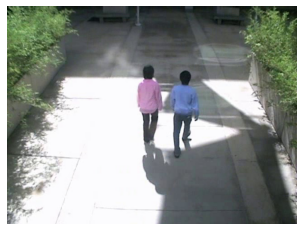

woman in yellow dress walks among silver truck


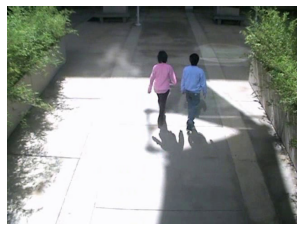

woman in yellow shirt and jeans walks among small


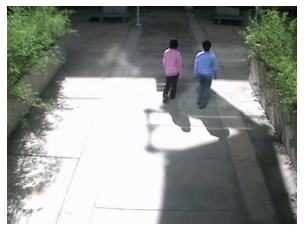

woman walking down the road holding bottle of people


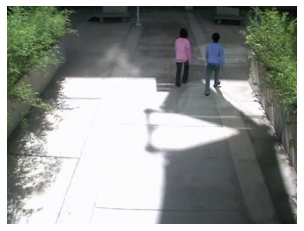

woman in yellow shirt and blue jeans walks down


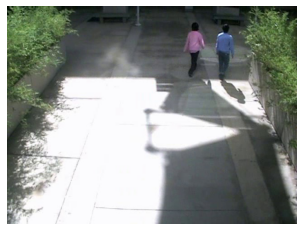

man in blue shirt and jeans is walking on


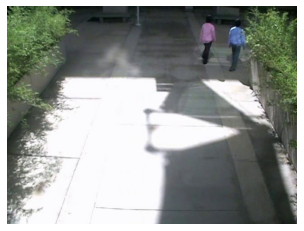

man walking on street corner


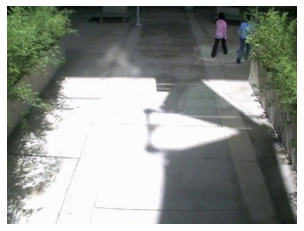

man in black shirt and jeans is walking on


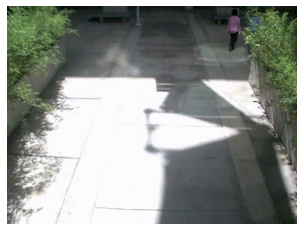

man in blue shirt begins to three flowers


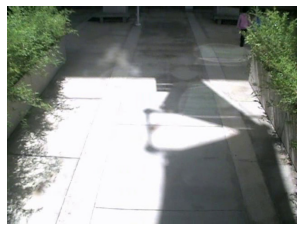

man in blue shirt and jeans is walking on


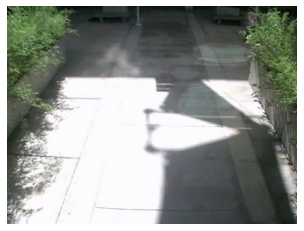

man in black shirt and jeans is walking on


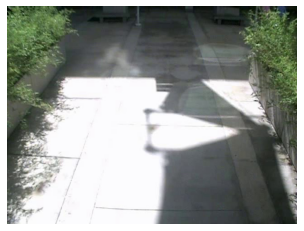

man in black shirt begins to man on public


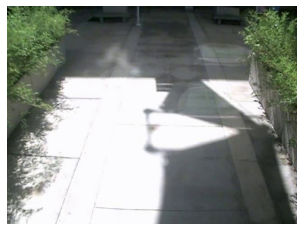

man in black shirt and jeans is walking on


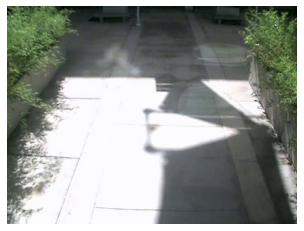

man in blue shirt and jeans is walking on


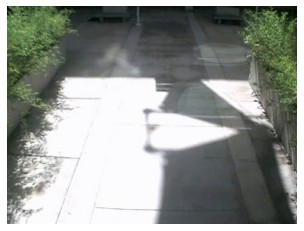

man in black shirt begins to man in red


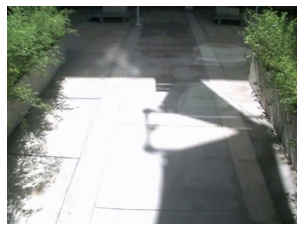

man walking on woodland path


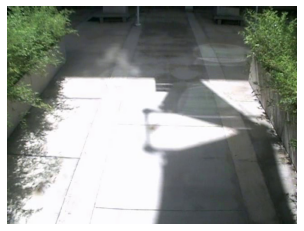

man walking on street tracks


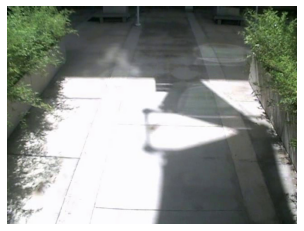

man walking on woodland steps


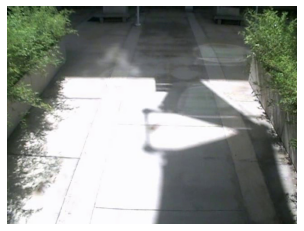

man walking on street corner


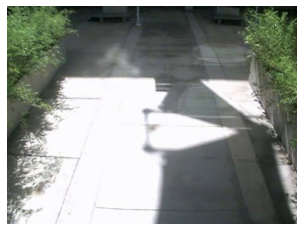

man in white shirt and black pants walking on


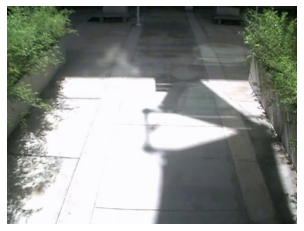

man walking on woodland steps


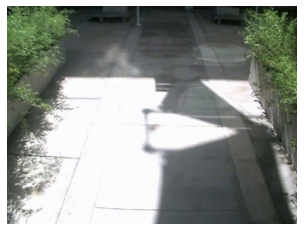

man walking on street corner


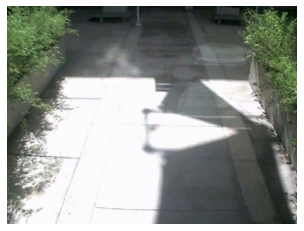

man begins to two flowers on bench


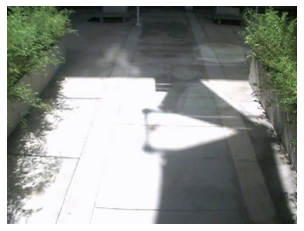

man in black shirt and jeans is walking on


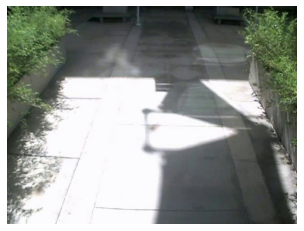

man in black shirt and jeans is walking on


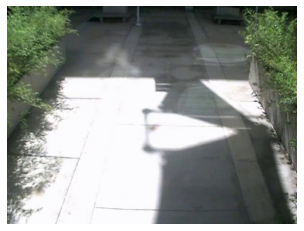

man in black shirt and jeans is walking on


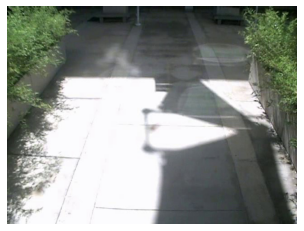

man walking on unicycle overlooking woodland


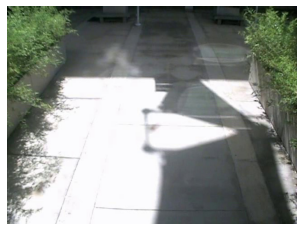

man in white shirt and black pants walks on


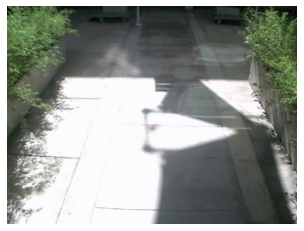

man in black shirt and jeans is walking on


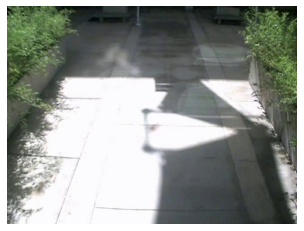

man in black shirt and jeans is walking on


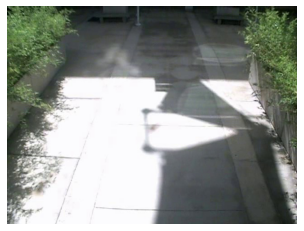

man in black shirt and black pants is walking


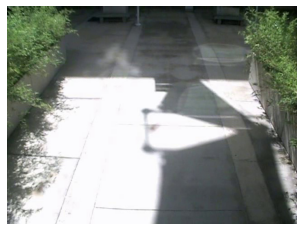

man walking on woodland stairs


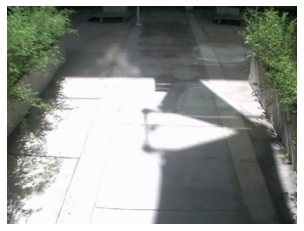

man in white shirt and black pants walking on


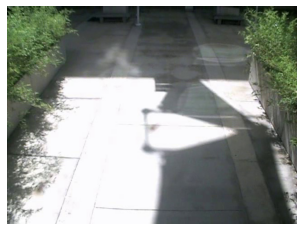

man in black shirt and jeans is walking on


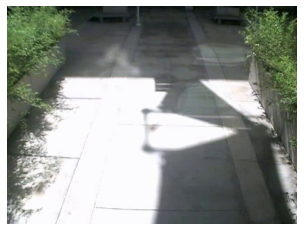

man walking on woodland stairs


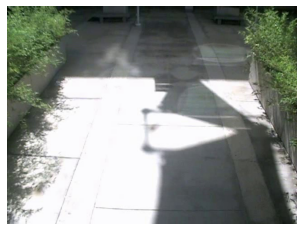

man in black shirt and jeans is walking on


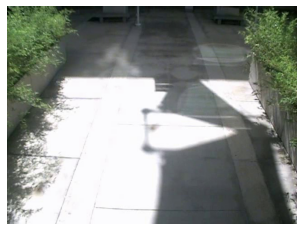

man in white shirt and black pants walking on


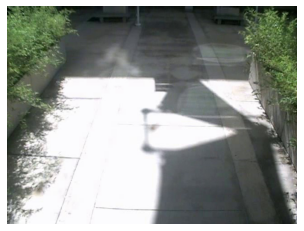

man in white shirt and jeans is walking on


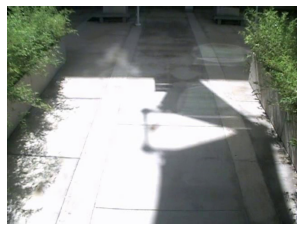

man in white shirt and jeans is walking on


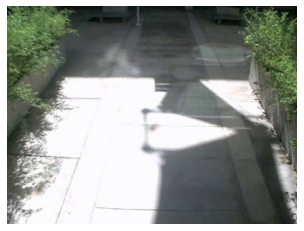

man in black shirt and jeans is walking on


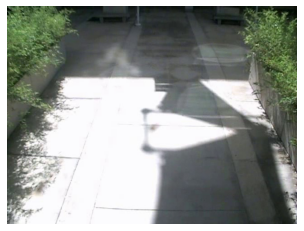

man in black shirt and jeans is walking on


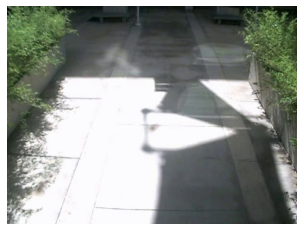

man in black shirt and jeans is walking on


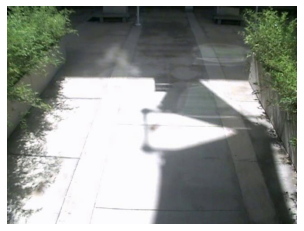

man in blue shirt and black pants is walking


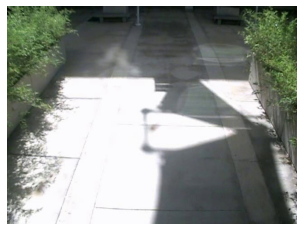

man walking on woodland path


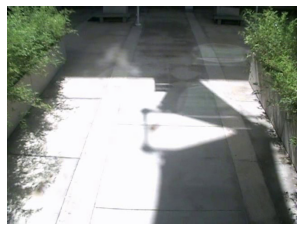

man in black shirt and jeans is walking on


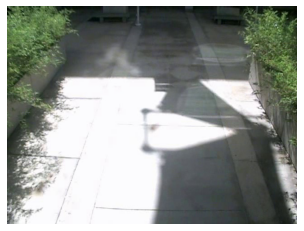

man in blue shirt and black pants walks on


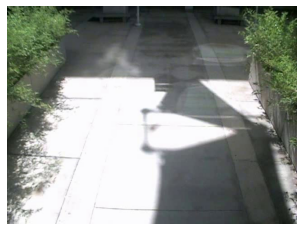

man in black shirt and jeans is walking on


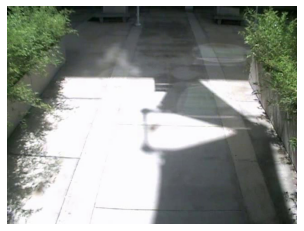

man in black shirt and jeans is walking on


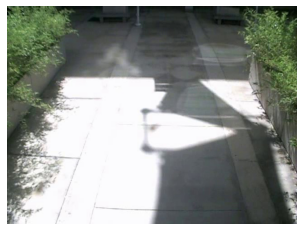

man in black shirt and jeans is walking on


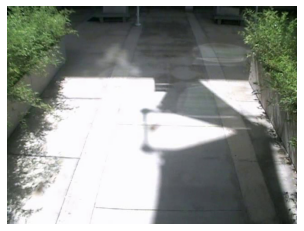

man in white shirt and jeans is walking on


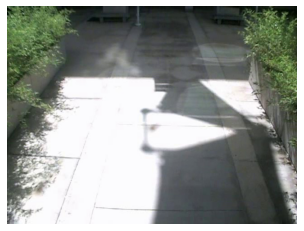

man in white shirt and jeans is walking on


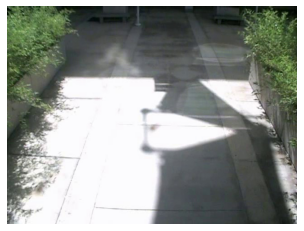

man in black shirt begins to three trees


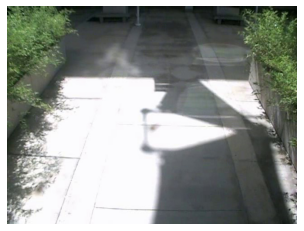

man in black shirt and jeans is walking on


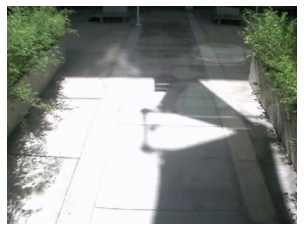

man in black shirt and jeans is walking on


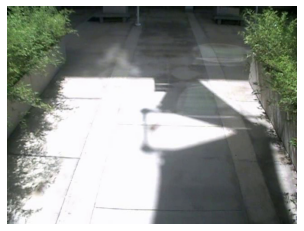

man in black shirt and jeans is walking on


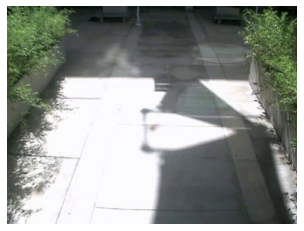

man in black shirt and jeans is walking on


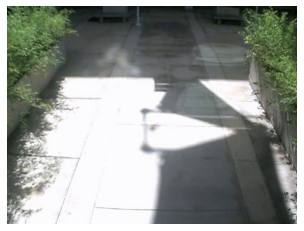

man walking on woodland path


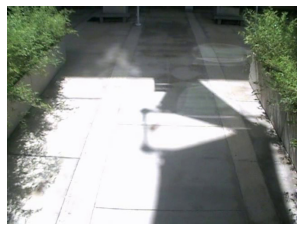

man walking on woodland path


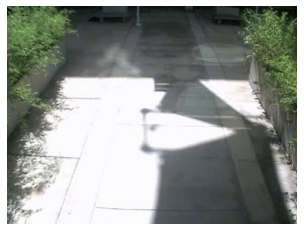

man in black shirt and jeans is walking on


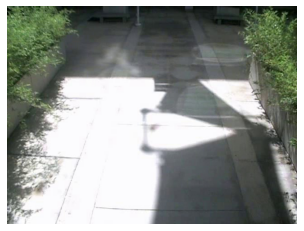

man walking on woodland steps


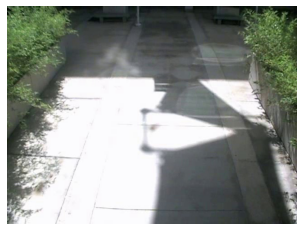

man in blue shirt and black pants is walking


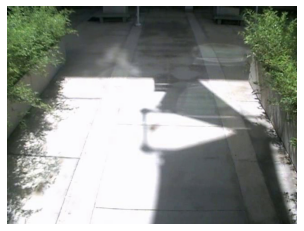

man in white shirt and black pants walks on


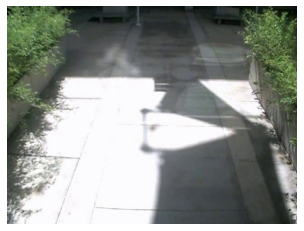

man in white shirt and black pants walks on


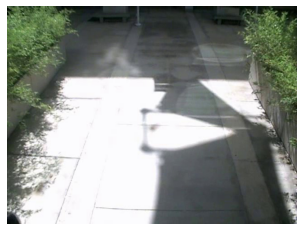

man in white shirt and black pants walks on


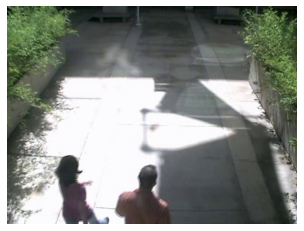

man in black shirt and jeans is shooting by


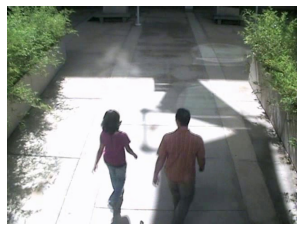

two girls stand in front of house


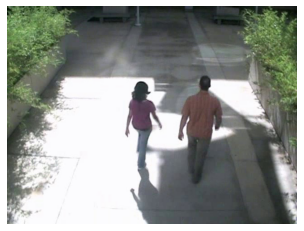

three people are walking on path in front of


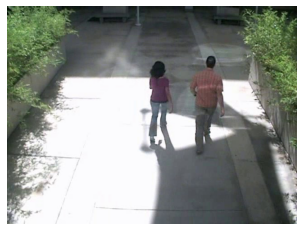

woman walking on sidewalk with several trees and buildings


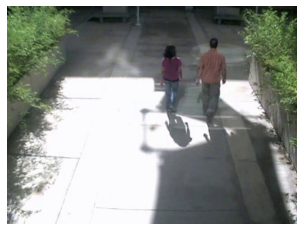

the skateboarder does jump while traffic the road


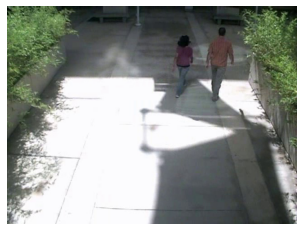

two girls are walking on path in water


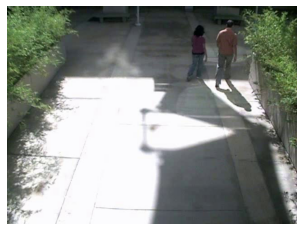

the night the city corner


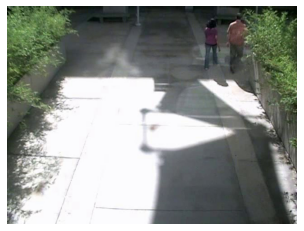

man in black shirt and jeans is walking on


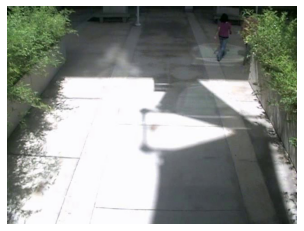

man in black shirt and jeans is walking on


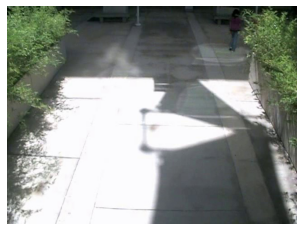

man in black shirt and jeans is walking on


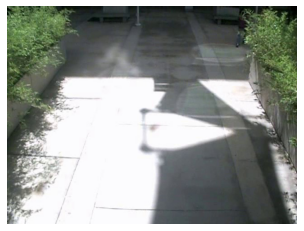

man in black shirt and jeans is walking on


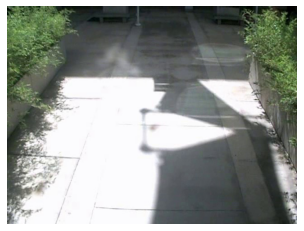

man walking on woodland steps


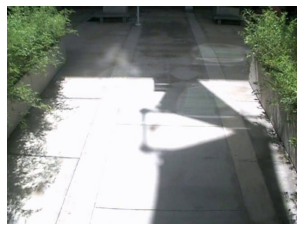

man in white shirt and black pants walking on


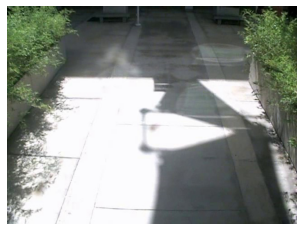

man in white shirt and black pants is walking


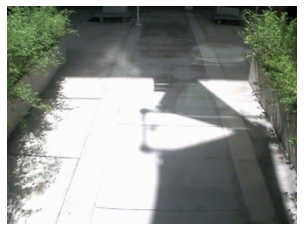

man in black shirt and black pants is walking


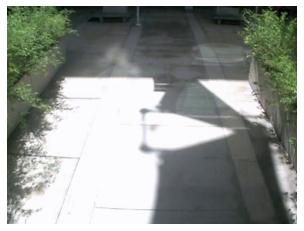

man walking on street corner


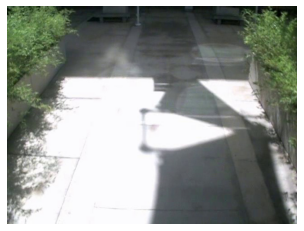

two people are walking on woodland path


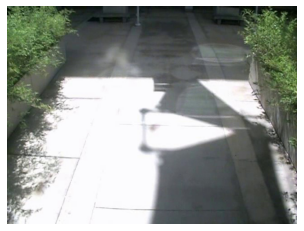

man in blue shirt and black pants is walking


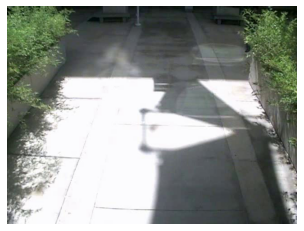

man in black shirt and jeans is walking on


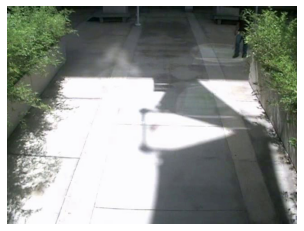

man in white shirt and black pants is walking


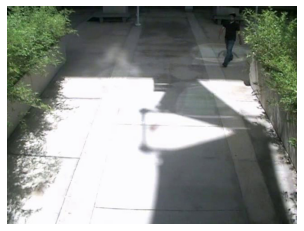

man in black shirt and jeans is walking on


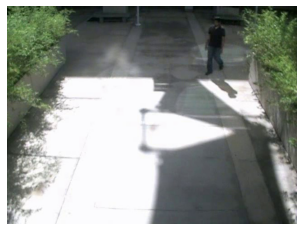

man in black shirt and jeans is walking on


In [80]:
"""Testing Summarized video frames """
captions = []
for i in range(268):
    # rn =  np.random.randint(0, 268)
    img_name = list(encoding_test.keys())[i]
    photo = encoding_test[img_name].reshape((1,2048))

    i = plt.imread(images+img_name)
    plt.imshow(i)
    plt.axis("off")
    plt.show()

    caption = predict_caption(photo)
    print(caption)
    captions.append(caption)

In [82]:
print(captions)

['man in black shirt and black pants is walking', 'man in white shirt and black pants is walking', 'man in white shirt and black pants walking on', 'man in white shirt and black pants walking on', 'man in white shirt and black pants walking on', 'man in white shirt and black pants walking on', 'man in white shirt and black pants walking on', 'man in white shirt and black pants walking on', 'man in white shirt and black pants walking on', 'man in white shirt and black pants walking on', 'man in white shirt and black pants is walking', 'man in white shirt and black pants is walking', 'man in white shirt and black pants walking on', 'man in white shirt and black pants walking on', 'man in white shirt and black pants walking on', 'man in white shirt and black pants walking on', 'man in white shirt and black pants walking on', 'man in black shirt and black pants is walking', 'man in white shirt and black pants is walking', 'man in white shirt and black pants walking on', 'man in black shirt

In [83]:
if captions is not None:
        print(captions)
        caption_list = captions
        caption_list = list(dict.fromkeys(caption_list))
        str1 = ['<start>','<end>', "''"]
        for i in str1:
            caption_list = [cap.replace(i, '') for cap in caption_list]
        print(caption_list)
        textfile = open("/content/drive/MyDrive/flic/Videocaption.txt", "w")
        for element in caption_list:
            textfile.write(element + "\n")
        textfile.close()

['man in black shirt and black pants is walking', 'man in white shirt and black pants is walking', 'man in white shirt and black pants walking on', 'man in white shirt and black pants walking on', 'man in white shirt and black pants walking on', 'man in white shirt and black pants walking on', 'man in white shirt and black pants walking on', 'man in white shirt and black pants walking on', 'man in white shirt and black pants walking on', 'man in white shirt and black pants walking on', 'man in white shirt and black pants is walking', 'man in white shirt and black pants is walking', 'man in white shirt and black pants walking on', 'man in white shirt and black pants walking on', 'man in white shirt and black pants walking on', 'man in white shirt and black pants walking on', 'man in white shirt and black pants walking on', 'man in black shirt and black pants is walking', 'man in white shirt and black pants is walking', 'man in white shirt and black pants walking on', 'man in black shirt